# <p style="background-color:#BF4764;font-family:newtimeroman;color:#FFFFFF;font-size:150%;text-align:center;border-radius:10px 10px;">📊 Análisis de la Personalidad del Cliente 📊</p>
---

[![Analisis-de-Persona-del-Cliente.png](https://i.postimg.cc/Qx8R4w4j/Analisis-de-Persona-del-Cliente.png)](https://postimg.cc/RqYsqsxY)

# <p style="background-color:#BF4764;font-family:newtimeroman;color:#FFFFFF;font-size:150%;text-align:center;border-radius:10px 10px;">Tabla de Contenidos</p>

<div class="alert alert-block alert-info" style="margin-top: 20px">

<font size = 3>
    
1. <a href="#sec_1">Introducción</a>  
2. <a href="#sec_2">Exploración del set de datos</a>  
3. <a href="#sec_3">Limpieza del set de datos</a>  
4. <a href="#sec_4">Análisis de los datos</a>  
5. <a href="#sec_5">Preprocesamiento</a>  
6. <a href="#sec_6">Clustering de Clientes</a> 
7. <a href="#sec_7">Reporte final</a>   

</font>
</div>

<a id='sec_1'></a>
## `1. Introducción`

`🛍️ Analisis de Personalidad del Cliente: Segmentación de Clientes para Estrategias de Marketing 🛍️`

Analizamos los datos de campañas 📢 y los montos de gasto 💰 de los últimos dos años para entender la personalidad de compra de los clientes. El objetivo es segmentarlos estratégicamente 🎯, optimizando recursos y mejorando nuestras campañas.

En lugar de estrategias masivas 💸, nos enfocamos en identificar los grupos con mayor probabilidad de conversión, personalizando las campañas y aumentando su efectividad. 🚀

**1.2. Recursos disponibles**
- [Set de datos Marketing_Camapaña](marketing_campaign.csv)

**1.3. Diccionario de datos disponibles**
| **Clave** | **Descripción** | **Tipo de dato** |
|---|---|---|
| ID | identificador único del cliente | Int |
| Year_Birth | Año de nacimiento | Int |
| Education | Nivel de educación | Object |
| Marital_Status | Estado civil | Object |
| Income | Ingreso anual | Float |
| Kidhome | Niños en el hogar | Int |
| Teenhome | Adolescentes en el hogar | Int |
| Dt_Customer | Fecha de alta del cliente | Object |
| Recency | Número de días desde la última compra| Int |
| Complain | 1 si el cliente se quejó en los últimos 2 años, 0 en caso contrario | Int |
| MntWines | Monto gastado en vino en los últimos 2 años | Int |
| MntFruits | Monto gastado en frutas en los últimos 2 años | Int |
| MntMeatProducts | Monto gastado en carne en los últimos 2 años | Int |
| MntFishProducts | Monto gastado en pescado en los últimos 2 años | Int |
| MntSweetProducts | Monto gastadoa en dulces en los últimos 2 años | Int |
| MntGoldProds | Monto gastado en oro en los últimos 2 años | Int |
| NumDealsPurchases | Compras realizadas con descuento | Int |
| AcceptedCmp1 | 1 aceptó la oferta en la primera campaña, 0 en caso contrario | Int |
| AcceptedCmp2 | 1 aceptó la oferta en la segunda campaña, 0 en caso contrario | Int |
| AcceptedCmp3 | 1 aceptó la oferta en la tercera campaña, 0 en caso contrario | Int |
| AcceptedCmp4 | 1 aceptó la oferta en la cuarta campaña, 0 en caso contrario | Int |
| AcceptedCmp5 | 1 aceptó la oferta en la quinta campaña, 0 en caso contrario | Int |
| Response | 1 si el cliente aceptó la oferta en la última campaña, 0 en caso contrario | Int |
| NumWebPurchases | Compras realizadas a través del sitio web de la empresa | Int |
| NumCatalogPurchases | Compras realizadas mediante un catálogo | Int |
| NumStorePurchases | Compras realizadas directamente en tiendas | Int |
| NumWebVisitsMonth | Visitas al sitio web de la empresa en el último mes | Int |

<a id='sec_2'></a>
## `2. Exploración del set de datos`

El objetivo de esta fase es poder familiarizarnos con la información contenida en el set de datos.

1. Leer el set de datos
2. Entender tamaño, columnas y filas del set de datos
3. Entender qué tipos de datos tenemos en cada columna
4. Verificar si hay datos faltantes y valores duplicados

**2.1. Leer el set de datos**

In [995]:
import pandas as pd

In [996]:
df = pd.read_csv(r"marketing_campaign.csv",sep='\t')
df.head(5)

,ID,Year_Birth,Education,Marital_Status,Income,Kidhome,Teenhome,Dt_Customer,Recency,MntWines,...,NumWebVisitsMonth,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,Z_CostContact,Z_Revenue,Response
0,5524,1957,Graduation,Single,58138.0,0,0,04-09-2012,58,635,...,7,0,0,0,0,0,0,3,11,1
1,2174,1954,Graduation,Single,46344.0,1,1,08-03-2014,38,11,...,5,0,0,0,0,0,0,3,11,0
2,4141,1965,Graduation,Together,71613.0,0,0,21-08-2013,26,426,...,4,0,0,0,0,0,0,3,11,0
3,6182,1984,Graduation,Together,26646.0,1,0,10-02-2014,26,11,...,6,0,0,0,0,0,0,3,11,0
4,5324,1981,PhD,Married,58293.0,1,0,19-01-2014,94,173,...,5,0,0,0,0,0,0,3,11,0


**2.2. Entender tamaño, columnas y filas del set de datos**

In [997]:
print(f'El número de filas es: {df.shape[0]}')
print(f'El número de columnas es: {df.shape[1]}')

El número de filas es: 2240
El número de columnas es: 29


In [998]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2240 entries, 0 to 2239
Data columns (total 29 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   ID                   2240 non-null   int64  
 1   Year_Birth           2240 non-null   int64  
 2   Education            2240 non-null   object 
 3   Marital_Status       2240 non-null   object 
 4   Income               2216 non-null   float64
 5   Kidhome              2240 non-null   int64  
 6   Teenhome             2240 non-null   int64  
 7   Dt_Customer          2240 non-null   object 
 8   Recency              2240 non-null   int64  
 9   MntWines             2240 non-null   int64  
 10  MntFruits            2240 non-null   int64  
 11  MntMeatProducts      2240 non-null   int64  
 12  MntFishProducts      2240 non-null   int64  
 13  MntSweetProducts     2240 non-null   int64  
 14  MntGoldProds         2240 non-null   int64  
 15  NumDealsPurchases    2240 non-null   i

**2.3. Entender qué tipos de datos tenemos en cada columna**

In [999]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2240 entries, 0 to 2239
Data columns (total 29 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   ID                   2240 non-null   int64  
 1   Year_Birth           2240 non-null   int64  
 2   Education            2240 non-null   object 
 3   Marital_Status       2240 non-null   object 
 4   Income               2216 non-null   float64
 5   Kidhome              2240 non-null   int64  
 6   Teenhome             2240 non-null   int64  
 7   Dt_Customer          2240 non-null   object 
 8   Recency              2240 non-null   int64  
 9   MntWines             2240 non-null   int64  
 10  MntFruits            2240 non-null   int64  
 11  MntMeatProducts      2240 non-null   int64  
 12  MntFishProducts      2240 non-null   int64  
 13  MntSweetProducts     2240 non-null   int64  
 14  MntGoldProds         2240 non-null   int64  
 15  NumDealsPurchases    2240 non-null   i

>**Observación**
> - Al poder observar a mas detalle el tipo de dato que tiene cada columna, se pudo ver que exiten datos de tipo `int` , `float` y `Object`.
> - Se puede observar que tenemos la `fecha de alta del cliente` como tipo de dato `Object`, el cual en caso se requiera analizarlo se podria cambiar a tipo de dato`Date`

**2.4. Verificar si hay datos faltantes y valores duplicados**

In [1000]:
df.duplicated().sum()

0

>**Observación**
> - Al observar se pudo evidenciar que `no hay valores duplicados.`

In [1001]:
df.isna().sum()

ID                      0
Year_Birth              0
Education               0
Marital_Status          0
Income                 24
Kidhome                 0
Teenhome                0
Dt_Customer             0
Recency                 0
MntWines                0
MntFruits               0
MntMeatProducts         0
MntFishProducts         0
MntSweetProducts        0
MntGoldProds            0
NumDealsPurchases       0
NumWebPurchases         0
NumCatalogPurchases     0
NumStorePurchases       0
NumWebVisitsMonth       0
AcceptedCmp3            0
AcceptedCmp4            0
AcceptedCmp5            0
AcceptedCmp1            0
AcceptedCmp2            0
Complain                0
Z_CostContact           0
Z_Revenue               0
Response                0
dtype: int64

>**Observación**
> - Al observar se pudo evidenciar que  hay valores faltantes en la columna `Income`.

<a id='sec_3'></a>
## `3. Limpieza de los datos`

Etapas de limpieza:

1. Revisión y eliminación datos duplicados
2. Eliminación de columnas innecesarias
3. Revisión y imputación de valores faltantes
4. Creación de nuevas columnas(caracteristicas)
5. Revisión de columnas categoricas
6. Eliminación de columnas innecesarias 2.0
7. Revisión o eliminación de valores outliers

Implementemos cada fase teniendo en cuenta las observaciones que hemos hecho hasta el momento.

**3.1 Revisión y eliminación datos duplicados**

In [1002]:
df = df.drop_duplicates()

In [1003]:
df.duplicated().sum()

0

>**Observación**
> - Al observar se pudo evidenciar que ya no se cuenta con valores duplicados

**3.2. Eliminación de columnas innecesarias**

In [1004]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2240 entries, 0 to 2239
Data columns (total 29 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   ID                   2240 non-null   int64  
 1   Year_Birth           2240 non-null   int64  
 2   Education            2240 non-null   object 
 3   Marital_Status       2240 non-null   object 
 4   Income               2216 non-null   float64
 5   Kidhome              2240 non-null   int64  
 6   Teenhome             2240 non-null   int64  
 7   Dt_Customer          2240 non-null   object 
 8   Recency              2240 non-null   int64  
 9   MntWines             2240 non-null   int64  
 10  MntFruits            2240 non-null   int64  
 11  MntMeatProducts      2240 non-null   int64  
 12  MntFishProducts      2240 non-null   int64  
 13  MntSweetProducts     2240 non-null   int64  
 14  MntGoldProds         2240 non-null   int64  
 15  NumDealsPurchases    2240 non-null   i

>**Observación**
> - De las observaciones hechas anteriormente concluimos que se pueden eliminar la columna: `ID`
> - Esto lo haremos con el método `drop`

In [1005]:
df = df.drop(columns=['ID'])
df

,Year_Birth,Education,Marital_Status,Income,Kidhome,Teenhome,Dt_Customer,Recency,MntWines,MntFruits,...,NumWebVisitsMonth,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,Z_CostContact,Z_Revenue,Response
0,1957,Graduation,Single,58138.0,0,0,04-09-2012,58,635,88,...,7,0,0,0,0,0,0,3,11,1
1,1954,Graduation,Single,46344.0,1,1,08-03-2014,38,11,1,...,5,0,0,0,0,0,0,3,11,0
2,1965,Graduation,Together,71613.0,0,0,21-08-2013,26,426,49,...,4,0,0,0,0,0,0,3,11,0
3,1984,Graduation,Together,26646.0,1,0,10-02-2014,26,11,4,...,6,0,0,0,0,0,0,3,11,0
4,1981,PhD,Married,58293.0,1,0,19-01-2014,94,173,43,...,5,0,0,0,0,0,0,3,11,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2235,1967,Graduation,Married,61223.0,0,1,13-06-2013,46,709,43,...,5,0,0,0,0,0,0,3,11,0
2236,1946,PhD,Together,64014.0,2,1,10-06-2014,56,406,0,...,7,0,0,0,1,0,0,3,11,0
2237,1981,Graduation,Divorced,56981.0,0,0,25-01-2014,91,908,48,...,6,0,1,0,0,0,0,3,11,0
2238,1956,Master,Together,69245.0,0,1,24-01-2014,8,428,30,...,3,0,0,0,0,0,0,3,11,0


>**Observación**
> - Como se puede observar se elimino la columna `ID`, debido a que no es necesario para nuestro modelo por queremos hacer un modelo de clustering y no seria lo recomendable tener un ID, perjudica a nuestro modelo

**3.3. Revisión y imputación de valores faltantes**

In [1006]:
df.isna().sum()

Year_Birth              0
Education               0
Marital_Status          0
Income                 24
Kidhome                 0
Teenhome                0
Dt_Customer             0
Recency                 0
MntWines                0
MntFruits               0
MntMeatProducts         0
MntFishProducts         0
MntSweetProducts        0
MntGoldProds            0
NumDealsPurchases       0
NumWebPurchases         0
NumCatalogPurchases     0
NumStorePurchases       0
NumWebVisitsMonth       0
AcceptedCmp3            0
AcceptedCmp4            0
AcceptedCmp5            0
AcceptedCmp1            0
AcceptedCmp2            0
Complain                0
Z_CostContact           0
Z_Revenue               0
Response                0
dtype: int64

In [1007]:
df_faltantes = df.isnull().sum()
porcentaje_faltantes = (df_faltantes / df.shape[0]) * 100
porcentaje_faltantes

Year_Birth             0.000000
Education              0.000000
Marital_Status         0.000000
Income                 1.071429
Kidhome                0.000000
Teenhome               0.000000
Dt_Customer            0.000000
Recency                0.000000
MntWines               0.000000
MntFruits              0.000000
MntMeatProducts        0.000000
MntFishProducts        0.000000
MntSweetProducts       0.000000
MntGoldProds           0.000000
NumDealsPurchases      0.000000
NumWebPurchases        0.000000
NumCatalogPurchases    0.000000
NumStorePurchases      0.000000
NumWebVisitsMonth      0.000000
AcceptedCmp3           0.000000
AcceptedCmp4           0.000000
AcceptedCmp5           0.000000
AcceptedCmp1           0.000000
AcceptedCmp2           0.000000
Complain               0.000000
Z_CostContact          0.000000
Z_Revenue              0.000000
Response               0.000000
dtype: float64

>**Observación**
> - Como se puede observar se tiene 24 valores faltantes en la columna `Income` es decir el 1.07 % de toda nuestra data

In [1008]:
df[['Income']].describe().T

,count,mean,std,min,25%,50%,75%,max
Income,2216.0,52247.251354,25173.076661,1730.0,35303.0,51381.5,68522.0,666666.0


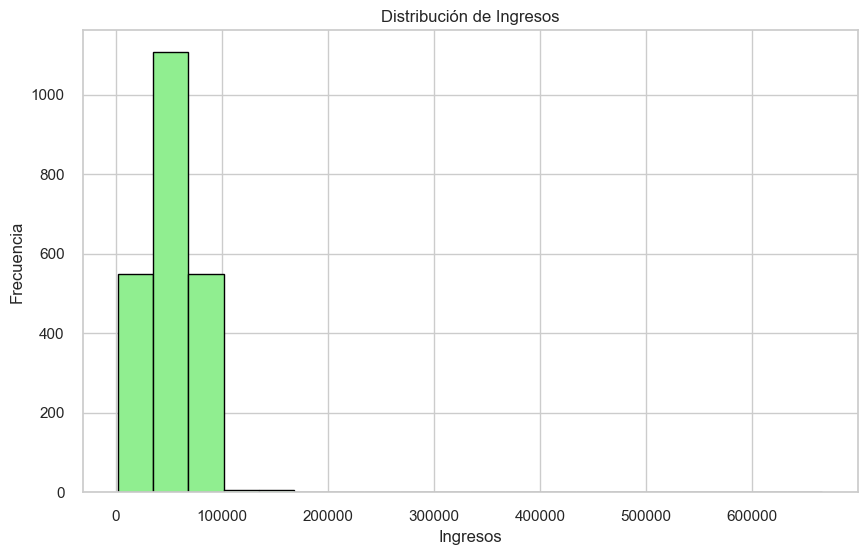

In [1009]:
import matplotlib.pyplot as plt

Income = df["Income"]

plt.figure(figsize=(10, 6))
plt.hist(Income, bins=20, edgecolor="black", color="lightgreen")  # Cambia el color aquí
plt.title("Distribución de Ingresos")
plt.xlabel("Ingresos")
plt.ylabel("Frecuencia")
plt.grid(True)
plt.show()


>**Observación**
> - Como se puede observar que nuestra columa Income, se tiene que nuestro datos estan entre el rango de 0 a 100000.

>**Sugerencia**
> - Se sugiere en este caso se pueda imputar los valores NAN con la mediana para que no afecte nuestra clasificación

In [1010]:
media_nan = df['Income'].median()
media_nan

51381.5

In [1011]:
df['Income'] = df['Income'].fillna(media_nan)

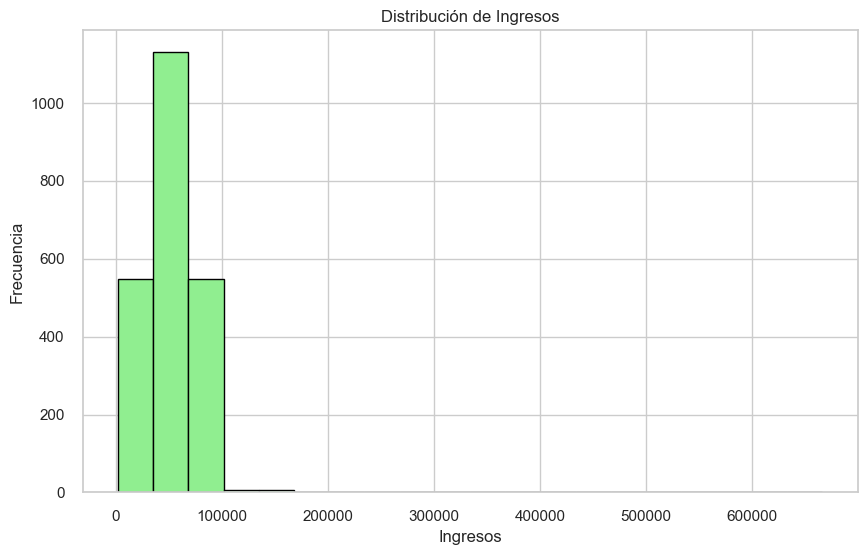

In [1012]:
Income = df["Income"]

plt.figure(figsize=(10, 6))
plt.hist(Income, bins=20, edgecolor="black", color="lightgreen")  # Cambia el color aquí
plt.title("Distribución de Ingresos")
plt.xlabel("Ingresos")
plt.ylabel("Frecuencia")
plt.grid(True)
plt.show()

>**Observación**
> - Como se puede observar se completaron los valores nan de la columna Income con la mediana y nuestra distribución no ha sido afecta , el cual es un buen indicador.

**3.4. Creación de nuevas columnas(caracteristicas)**

- *Creación de una columna Edad*

In [1013]:
df['Age'] = 2024 - df['Year_Birth']

>**Observación**
> - Se creo esta nueva columna Age con el fin de poder hacer una analisis más sencillo en rango de las edades de los clientes

- *Creación de una columna niñ@s*

In [1014]:
df["Children"]= df["Kidhome"]+ df["Teenhome"]

>**Observación**
> - Se creo esta nueva columna Children con el fin de poder hacer una analisis más sencillo del total de niños y adolescente que vive el cliente

- *Creación de una columna Gasto_Total*

In [1015]:
df["Gasto_Total"] = df["MntWines"] + df["MntFruits"] + df["MntMeatProducts"] + df["MntFishProducts"] + df["MntSweetProducts"] + df["MntGoldProds"]

**3.5. Revisión de columnas categoricas**

In [1016]:
df['Education'].value_counts()

Education
Graduation    1127
PhD            486
Master         370
2n Cycle       203
Basic           54
Name: count, dtype: int64

>**Observación**
> - Como se puede observar en la columna `Education`, se tiene diferentes valores de los cuales los clientes más frecuentes son los `egresados de la universidad`, y los no son clientes que han terminado el colegio `Basic`

>**Sugerencia**
> - Se sugiere que debido ala cantidad de valores que se tiene se podria unir 2n Cycle y Basic en una sola categoria que es `NoGraduation` y cambiar el nombre de la columna PhD por `DOCTORATE`

In [1017]:
df['Education'] = df['Education'].replace({'Basic':'NoGraduation','2n Cycle':'NoGraduation','PhD':'Doctorate'})

In [1018]:
df['Education'].value_counts()

Education
Graduation      1127
Doctorate        486
Master           370
NoGraduation     257
Name: count, dtype: int64

>**Observación**
> - Se puede observar que se tiene ahora solo 4 categorias en esta columna.

In [1019]:
df['Marital_Status'].value_counts()

Marital_Status
Married     864
Together    580
Single      480
Divorced    232
Widow        77
Alone         3
Absurd        2
YOLO          2
Name: count, dtype: int64

>**Obervación**
>- Se puede observar que en esta columna se tiene varias categorias las cuales seria lo recomendable solo trabajar con 2 y estandarizarlo, para una mejor clasificación

In [1020]:
df['Marital_Status'] = df['Marital_Status'].replace({'Single':'Soltero','Divorced':'Soltero','Widow':'Soltero','YOLO':'Soltero','Alone':'Soltero','Absurd':'Soltero','Married':'Con Pareja','Together':'Con Pareja'})

In [1021]:
df['Marital_Status'].value_counts()

Marital_Status
Con Pareja    1444
Soltero        796
Name: count, dtype: int64

In [1022]:
df.columns

Index(['Year_Birth', 'Education', 'Marital_Status', 'Income', 'Kidhome',
       'Teenhome', 'Dt_Customer', 'Recency', 'MntWines', 'MntFruits',
       'MntMeatProducts', 'MntFishProducts', 'MntSweetProducts',
       'MntGoldProds', 'NumDealsPurchases', 'NumWebPurchases',
       'NumCatalogPurchases', 'NumStorePurchases', 'NumWebVisitsMonth',
       'AcceptedCmp3', 'AcceptedCmp4', 'AcceptedCmp5', 'AcceptedCmp1',
       'AcceptedCmp2', 'Complain', 'Z_CostContact', 'Z_Revenue', 'Response',
       'Age', 'Children', 'Gasto_Total'],
      dtype='object')

**3.6.Eliminación de columnas innecesarias 2.0**

In [1023]:
delete = ["Year_Birth", "Kidhome", "Teenhome",'Z_CostContact','Z_Revenue','Dt_Customer']
df = df.drop(delete, axis=1)


**3.7. Revisión o eliminación de valores outliers**

In [1024]:
df

,Education,Marital_Status,Income,Recency,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds,...,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,Response,Age,Children,Gasto_Total
0,Graduation,Soltero,58138.0,58,635,88,546,172,88,88,...,0,0,0,0,0,0,1,67,0,1617
1,Graduation,Soltero,46344.0,38,11,1,6,2,1,6,...,0,0,0,0,0,0,0,70,2,27
2,Graduation,Con Pareja,71613.0,26,426,49,127,111,21,42,...,0,0,0,0,0,0,0,59,0,776
3,Graduation,Con Pareja,26646.0,26,11,4,20,10,3,5,...,0,0,0,0,0,0,0,40,1,53
4,Doctorate,Con Pareja,58293.0,94,173,43,118,46,27,15,...,0,0,0,0,0,0,0,43,1,422
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2235,Graduation,Con Pareja,61223.0,46,709,43,182,42,118,247,...,0,0,0,0,0,0,0,57,1,1341
2236,Doctorate,Con Pareja,64014.0,56,406,0,30,0,0,8,...,0,0,0,1,0,0,0,78,3,444
2237,Graduation,Soltero,56981.0,91,908,48,217,32,12,24,...,0,1,0,0,0,0,0,43,0,1241
2238,Master,Con Pareja,69245.0,8,428,30,214,80,30,61,...,0,0,0,0,0,0,0,68,1,843


**Revisión de Outliers en los montos por productos comprados**

In [1025]:
import plotly.graph_objs as go
import plotly.subplots as sp


fig = sp.make_subplots(rows=1, cols=5, subplot_titles=("MntWines", "MntFruits", "MntFishProducts", "MntSweetProducts", "MntGoldProds"))

fig.add_trace(go.Box(y=df['MntWines'], name='MntWines'), row=1, col=1)
fig.add_trace(go.Box(y=df['MntFruits'], name='MntFruits'), row=1, col=2)
fig.add_trace(go.Box(y=df['MntFishProducts'], name='MntFishProducts'), row=1, col=3)
fig.add_trace(go.Box(y=df['MntSweetProducts'], name='MntSweetProducts'), row=1, col=4)
fig.add_trace(go.Box(y=df['MntGoldProds'], name='MntGoldProds'), row=1, col=5)

fig.update_layout(
    title_text="Diagramas de caja de puntuaciones de evaluación",
    showlegend=False,
    height=500,
    width=1200
)
fig.show()

>**Observación**
>- Se puede observar en este gráfico anterior los montos gastados en diferentes productos y se tiene valores outliers las cuales se podria eliminar por que nos podrian generar ruido a nuestro modelo.

**Eliminación de Outliers en MntWines**

In [1026]:
df[df['MntWines']>1124]

,Education,Marital_Status,Income,Recency,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds,...,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,Response,Age,Children,Gasto_Total
111,Doctorate,Soltero,68126.0,40,1332,17,311,23,51,86,...,0,1,0,0,0,0,1,33,0,1820
161,Doctorate,Con Pareja,70356.0,20,1349,16,249,43,16,33,...,0,0,0,0,0,0,0,79,0,1706
175,Doctorate,Con Pareja,80427.0,56,1149,71,449,69,71,26,...,0,0,0,0,0,0,0,49,1,1835
209,Graduation,Soltero,64497.0,17,1170,48,320,42,32,192,...,1,0,0,0,0,0,1,70,1,1804
246,Graduation,Con Pareja,80134.0,40,1218,16,272,104,0,80,...,0,1,1,1,0,0,1,52,1,1690
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1961,Doctorate,Soltero,71670.0,8,1462,16,128,0,0,160,...,0,1,1,0,1,0,1,62,0,1766
1992,Master,Soltero,91712.0,47,1276,24,746,94,29,48,...,0,0,1,0,0,0,1,77,0,2217
2067,Doctorate,Con Pareja,77610.0,70,1245,33,332,21,33,16,...,0,0,0,0,0,0,0,72,1,1680
2098,Master,Con Pareja,81929.0,60,1486,55,278,49,0,185,...,1,0,1,0,0,0,1,48,1,2053


In [1027]:
df = df.drop(index=df[df['MntWines']>1124].index)

In [1028]:
fig = sp.make_subplots(rows=1, cols=5, subplot_titles=("MntWines", "MntFruits", "MntFishProducts", "MntSweetProducts", "MntGoldProds"))

fig.add_trace(go.Box(y=df['MntWines'], name='MntWines'), row=1, col=1)
fig.add_trace(go.Box(y=df['MntFruits'], name='MntFruits'), row=1, col=2)
fig.add_trace(go.Box(y=df['MntFishProducts'], name='MntFishProducts'), row=1, col=3)
fig.add_trace(go.Box(y=df['MntSweetProducts'], name='MntSweetProducts'), row=1, col=4)
fig.add_trace(go.Box(y=df['MntGoldProds'], name='MntGoldProds'), row=1, col=5)

fig.update_layout(
    title_text="Diagramas de caja de puntuaciones de evaluación",
    showlegend=False,
    height=500,
    width=1200
)
fig.show()

**Eliminación de Outliers en las demas columnas Mnt**

In [1029]:
columnas = ['MntFruits', 'MntMeatProducts', 'MntFishProducts', 'MntSweetProducts', 'MntGoldProds']
for col in columnas:
    print(f'Columna {col}')
    print('-'*30)
    print(f'{((df[df[col] >= 80].count()*100)/2177).round(2)}')
    print('')

Columna MntFruits
------------------------------
Education              10.79
Marital_Status         10.79
Income                 10.79
Recency                10.79
MntWines               10.79
MntFruits              10.79
MntMeatProducts        10.79
MntFishProducts        10.79
MntSweetProducts       10.79
MntGoldProds           10.79
NumDealsPurchases      10.79
NumWebPurchases        10.79
NumCatalogPurchases    10.79
NumStorePurchases      10.79
NumWebVisitsMonth      10.79
AcceptedCmp3           10.79
AcceptedCmp4           10.79
AcceptedCmp5           10.79
AcceptedCmp1           10.79
AcceptedCmp2           10.79
Complain               10.79
Response               10.79
Age                    10.79
Children               10.79
Gasto_Total            10.79
dtype: float64

Columna MntMeatProducts
------------------------------
Education              45.06
Marital_Status         45.06
Income                 45.06
Recency                45.06
MntWines               45.06
MntFruits 

>**Observación**
>- Se puede observar en las demas columnas de los montos de los productos se tiene un data en mayor porcentaje de outliers mayores al 11%, se sugiere que no se elimine estos outliers por que nos podrian ocacionar perdidas importantes de datos.

**Eliminación de Outliers en las columnas Income y Recency**

In [1030]:
fig = sp.make_subplots(rows=1, cols=2, subplot_titles=("Income", "Recency"))

fig.add_trace(go.Box(y=df['Income'], name='Income'), row=1, col=1)
fig.add_trace(go.Box(y=df['Recency'], name='Recency'), row=1, col=2)

fig.update_layout(
    title_text="Diagramas de caja de Income y Recency",
    showlegend=False,
    height=500,
    width=1200
)
fig.show()

>**Observación**
>- Se puede observar que se tiene valores outliers en Income las cuales se pueden eliminar debido a que son pocos valores, por el lado de la columna  Recency no se tiene valores outliers

In [1031]:
df[df['Income']>157733]

,Education,Marital_Status,Income,Recency,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds,...,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,Response,Age,Children,Gasto_Total
617,Doctorate,Con Pareja,162397.0,31,85,1,16,2,1,2,...,0,0,0,0,0,0,0,48,2,107
687,Doctorate,Con Pareja,160803.0,21,55,16,1622,17,3,4,...,0,0,0,0,0,0,0,42,0,1717
2233,Graduation,Con Pareja,666666.0,23,9,14,18,8,1,12,...,0,0,0,0,0,0,0,47,1,62


In [1032]:
df = df.drop(index=df[df['Income']>153923].index)

In [1033]:
fig = sp.make_subplots(rows=1, cols=2, subplot_titles=("Income", "Recency"))

fig.add_trace(go.Box(y=df['Income'], name='Income'), row=1, col=1)
fig.add_trace(go.Box(y=df['Recency'], name='Recency'), row=1, col=2)

fig.update_layout(
    title_text="Diagramas de caja de Income y Recency",
    showlegend=False,
    height=500,
    width=1200
)
fig.show()

>**Observación**
>- Se puede observar que en ambas columnas Income y Recency se ya no se cuenta con valores outliers

**Eliminación de Outliers en las columnas NumDealsPurchases , NumWebPurchases, NumCatalogPurchases, NumStorePurchases y NumWebVisitsMonth**

In [1034]:
fig = sp.make_subplots(rows=1, cols=5, subplot_titles=("NumDealsPurchases", "NumWebPurchases", "NumCatalogPurchases", "NumStorePurchases", "NumWebVisitsMonth"))

fig.add_trace(go.Box(y=df['NumDealsPurchases'], name='NumDealsPurchases'), row=1, col=1)
fig.add_trace(go.Box(y=df['NumWebPurchases'], name='NumWebPurchases'), row=1, col=2)
fig.add_trace(go.Box(y=df['NumCatalogPurchases'], name='NumCatalogPurchases'), row=1, col=3)
fig.add_trace(go.Box(y=df['NumStorePurchases'], name='NumStorePurchases'), row=1, col=4)
fig.add_trace(go.Box(y=df['NumWebVisitsMonth'], name='NumWebVisitsMonth'), row=1, col=5)

fig.update_layout(
    title_text="Diagramas de caja de puntuaciones de evaluación",
    showlegend=False,
    height=500,
    width=1200
)
fig.show()

>**Observación**
>- Se puede observar que en las columnas NumDealsPurchases, NumWebPurchases, NumCatalogPurchases y NumWebVisitsMonth se tiene valores outliers en poca cantidad las cuales se deben de eliminar y por otro lado en la columna NumStorePurchases no se tiene valores outlieres

In [1035]:
df = df.drop(index=df[df['NumDealsPurchases']>6].index)
df = df.drop(index=df[df['NumWebPurchases']>22].index)
df = df.drop(index=df[df['NumCatalogPurchases']>10].index)
df = df.drop(index=df[df['NumWebVisitsMonth']>12].index)

In [1036]:
fig = sp.make_subplots(rows=1, cols=5, subplot_titles=("NumDealsPurchases", "NumWebPurchases", "NumCatalogPurchases", "NumStorePurchases", "NumWebVisitsMonth"))

fig.add_trace(go.Box(y=df['NumDealsPurchases'], name='NumDealsPurchases'), row=1, col=1)
fig.add_trace(go.Box(y=df['NumWebPurchases'], name='NumWebPurchases'), row=1, col=2)
fig.add_trace(go.Box(y=df['NumCatalogPurchases'], name='NumCatalogPurchases'), row=1, col=3)
fig.add_trace(go.Box(y=df['NumStorePurchases'], name='NumStorePurchases'), row=1, col=4)
fig.add_trace(go.Box(y=df['NumWebVisitsMonth'], name='NumWebVisitsMonth'), row=1, col=5)

fig.update_layout(
    title_text="Diagramas de caja de puntuaciones de evaluación",
    showlegend=False,
    height=500,
    width=1200
)
fig.show()

>**Observación**
>- Se puede observar que ya no se cuenta con valores outliers en ninguna de las columnas

**Eliminación de Outliers en la columna Age**

In [1037]:
fig = sp.make_subplots(rows=1, cols=1, subplot_titles=("Age"))

fig.add_trace(go.Box(y=df['Age'], name='Age'), row=1, col=1)

fig.update_layout(
    title_text="Diagramas de caja de puntuaciones de evaluación",
    showlegend=False,
    height=500,
    width=1200
)
fig.show()

>**Observación**
>- Se puede observar en el gráfico de la columna Edad, que se tiene valores outliers, las cuales se deben eliminar para no causar ruido a nuestro modelo

In [1038]:
df[df['Age']>123]

,Education,Marital_Status,Income,Recency,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds,...,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,Response,Age,Children,Gasto_Total
192,NoGraduation,Soltero,36640.0,99,15,6,8,7,4,25,...,0,0,0,0,0,1,0,124,1,65
239,NoGraduation,Soltero,60182.0,23,8,0,5,7,0,2,...,0,0,0,0,0,0,0,131,1,22
339,Doctorate,Con Pareja,83532.0,36,755,144,562,104,64,224,...,0,0,1,0,0,0,0,125,0,1853


In [1039]:
df = df.drop(index=df[df['Age']>123].index)

In [1040]:
fig = sp.make_subplots(rows=1, cols=1, subplot_titles=("Age"))

fig.add_trace(go.Box(y=df['Age'], name='Age'), row=1, col=1)

fig.update_layout(
    title_text="Diagramas de caja de puntuaciones de evaluación",
    showlegend=False,
    height=500,
    width=1200
)
fig.show()

>**Observación**
>- Se puede observar en el gráfico de la columna Edad, que ya no se tiene valores outliers.

<a id='sec_4'></a>
## `4. Análisis de los datos`

En este caso debemos regresar al planteamiento inicial del problema y analizar nuestra data que hemos limpiado anteriormente.

Etapas de Análisis de los datos:

1. Visualizar distribución de los datos

**4.1. Visualizar distribución de los datos**

In [1041]:
dt = df.select_dtypes(include='number')

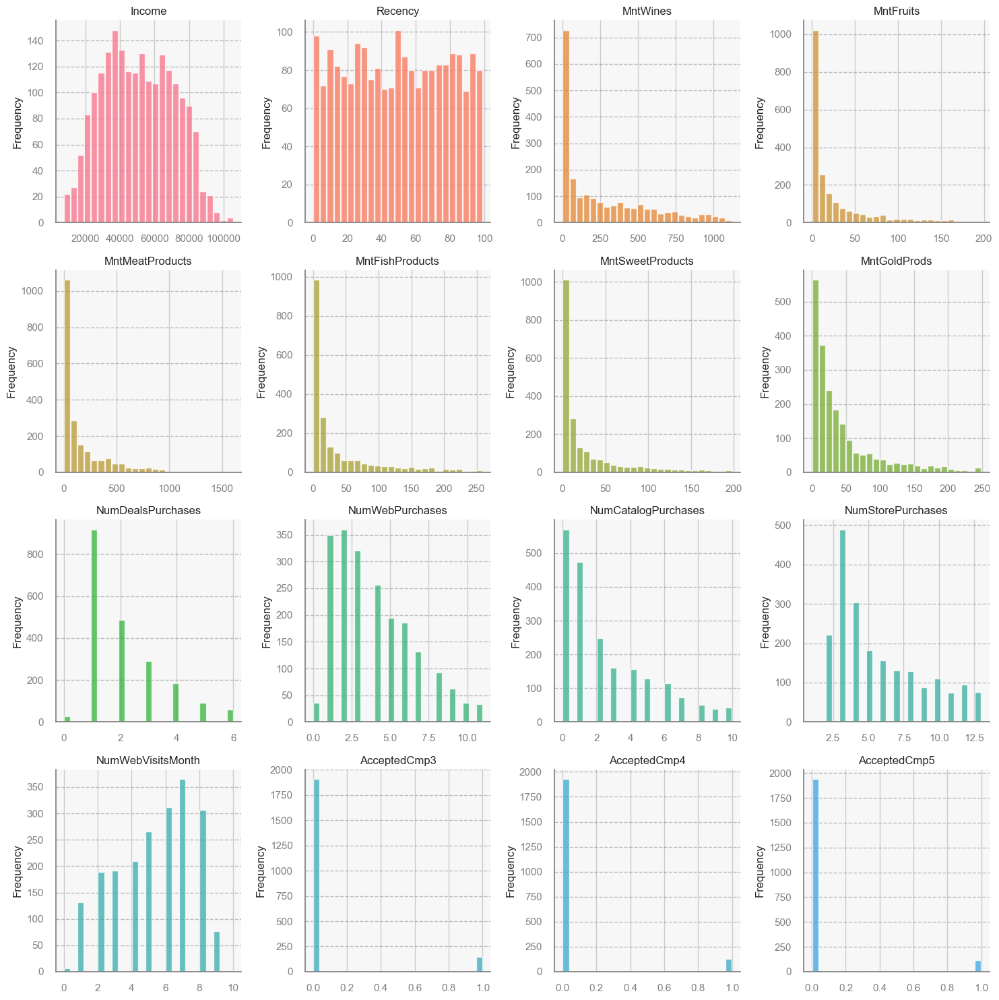

In [1042]:
import seaborn as sns
sns.set(style="whitegrid")
fig, axes = plt.subplots(nrows=4, ncols=4, figsize=(15, 15)) 
axes = axes.flatten()

colors = sns.color_palette("husl", len(dt.columns))
for i, col in enumerate(dt.columns):
    if i < len(axes):  
        df[col].plot.hist(bins=25, ax=axes[i], color=colors[i], rwidth=0.9, alpha=0.75)
        axes[i].set_title(col, fontsize=12)
        axes[i].grid(axis='y', linestyle='--', color='gray', alpha=0.5)
        axes[i].set_facecolor('#f7f7f7')
        axes[i].spines['top'].set_visible(False)
        axes[i].spines['right'].set_visible(False)
        axes[i].spines['left'].set_color('gray')
        axes[i].spines['bottom'].set_color('gray')
        axes[i].tick_params(axis='x', colors='gray')
        axes[i].tick_params(axis='y', colors='gray')

for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

>**Observación**
>- Se puede observar que nuestros columnas númericas tiene valores pequeños en su mayoria a ecepción de la columan Income, hagamos un analisis más profundo.

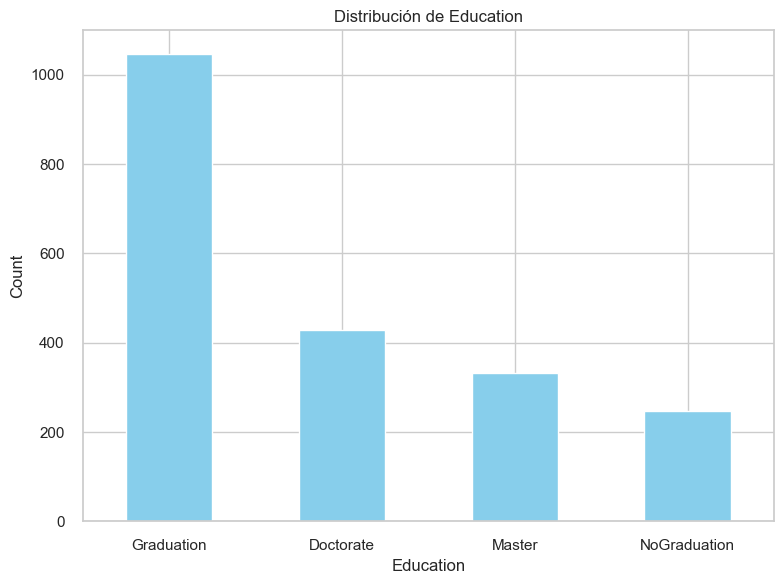

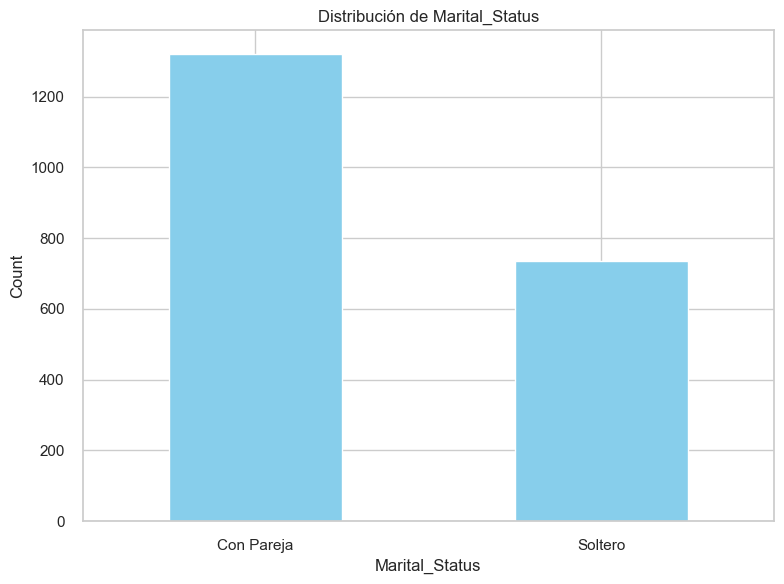

In [1043]:
categorical_cols = ['Education', 'Marital_Status']
for col in categorical_cols:
    plt.figure(figsize=(8, 6))
    df[col].value_counts().plot(kind='bar', color='skyblue')
    plt.title(f'Distribución de {col}')
    plt.ylabel('Count')
    plt.xticks(rotation=0)  
    plt.tight_layout()
    plt.show()

>**Observación**
>- Se puede observar en nuestro gráfico de Distribución de Educación que se tiene más clientes que han terminando la universidad, luego a cliente que tienen doctorado.

>**Observación**
>- Se puede observar en nuestro gráfico de Distribución de Marital_Status que se tiene más clientes que tienen pareja y por otro lado se tiene clientes solteros las cuales son casi la mitad de clientes con pareja

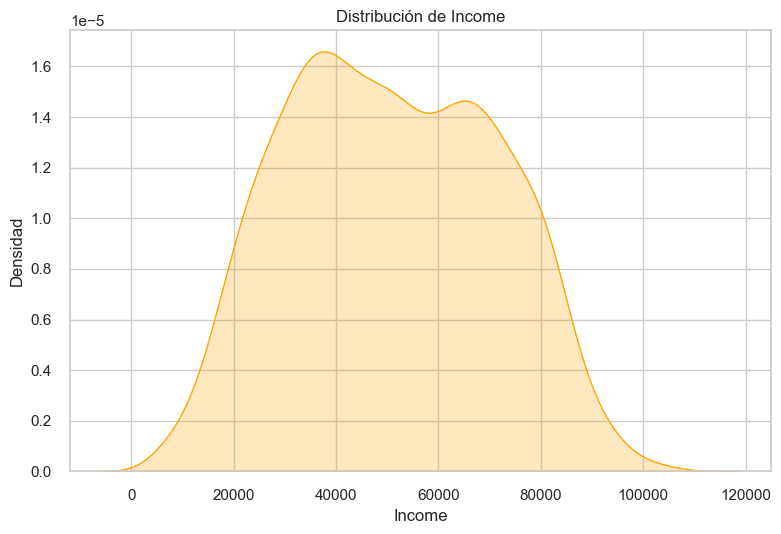

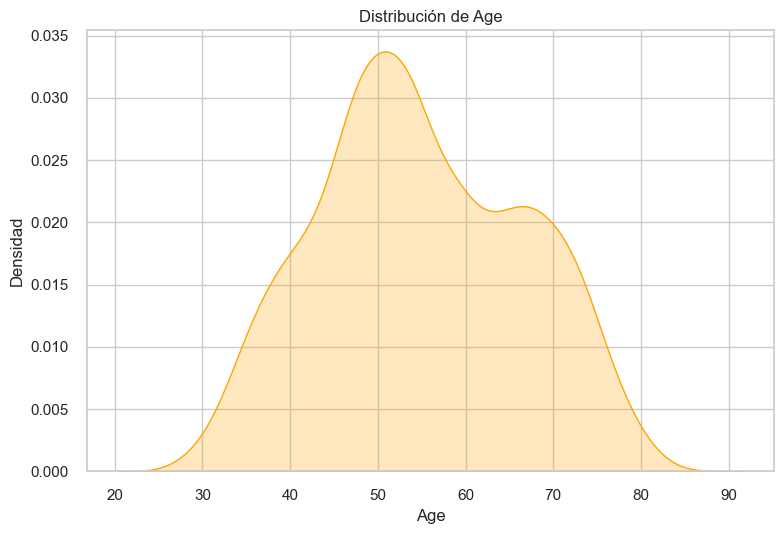

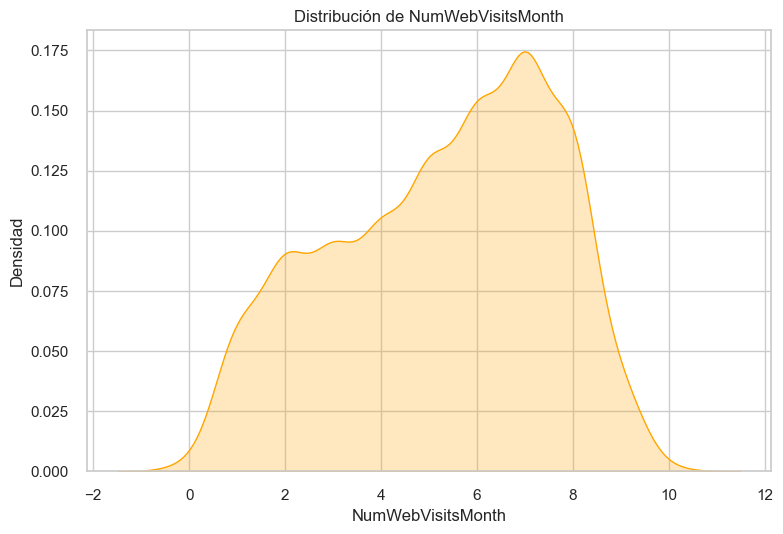

In [1044]:
import plotly.express as px
numerical_cols = ['Income', 'Age', 'NumWebVisitsMonth']
for col in numerical_cols:
    sns.kdeplot(df[col], fill=True, color='orange')  # adjust color as desired
    plt.title(f'Distribución de {col}')
    plt.xlabel(col)
    plt.ylabel('Densidad')
    plt.grid(True)
    plt.tight_layout()
    plt.show()

>**Observaciones**
>- Se puede observar en el primer gráfico de densidad de la columna Income, que nuestra distribución de los ingreso de los clientes esta en el rango de 20000 a 80000.
>- Se puede observar en el segundo gráfico de densidad de la columna Age, que nuestra distribución de los ingreso de las edades esta en el rango de 30 a 75.
>- Se puede observar en el tercer gráfico de densidad de la columna NewWebVisitsMoth, que nuestra distribución de los números  de visitas ala web durante el último mes esta en el rango de 2 a 8.

In [1045]:
group_col = 'Marital_Status'
numeric_cols = ['Income', 'Age']

for col in numeric_cols:
    fig = px.box(df, x=col, y=group_col, points="all")  # Use "points" argument
    fig.update_layout(
        title=f'Box Plot de {col} por {group_col}',
        xaxis_title=col,
        yaxis_title=group_col,
    )
    fig.show()

>**Observación**
>- En el primer gráficos se pude observar que el salario de los clientes solteros y con pareja estan casi en el mismo rango de 34.3k - 68.04k, y el promedio de los clientes con pareja es 50.27k de Ingresos, mientras el de solteros el promedio de ingresos es 49.76k.
>- En sel sgundo gráfico se puede observar que las edades de los clientes solteros y con pareja estan casi en el mismo rango de 46 - 65, y el promedio de las edades de los clientes con pareja es 53 años, mientras que el de solterios el promedio de edad es 54.
>- Debido a que esta data es un poco antigua y tiene ya tiempos en datos historicos las edades estan en esos rangos.

**Exportando nuestra data antes de ser escalada y este limpiea**

In [1046]:
df.to_csv('data_limpia.csv', index=True, header=True, encoding='utf-8')

<a id='sec_5'></a>
## `5. Preprocesamiento`

En este caso debemos preprocesar nuestros datos para luego llevarlo a nuestro modelo.

Etapas de Análisis de los datos:

1. Escalando nuestras columnas

**5.1. Escalando nuestras columnas**

>**Obervación de valores outliers**
>- Analizado ya el dato en pasos anteriores de exploración de los datos se vio que se cuenta con valores outliers que no se pueden eliminar por que es parte de los datos importantes , es por ello que se debe usar el RobustScaler que ayuda a que esos outliers no anteren nuestra clasificación

In [1047]:
from sklearn.compose import make_column_selector
from sklearn.preprocessing import RobustScaler, StandardScaler, OrdinalEncoder, OneHotEncoder
from sklearn.compose import make_column_transformer
from sklearn.pipeline import make_pipeline

In [1048]:
num_selector = make_column_selector(dtype_include='number')
col_ordinal = ['Education']
col_nominal = ['Marital_Status']

In [1049]:
robust_scaler = RobustScaler(with_centering=False)
ordinal_encoder = OrdinalEncoder()
nominal_encoder = OneHotEncoder()

In [1050]:
col_transformer = make_column_transformer((make_pipeline(robust_scaler), num_selector),
                                          (make_pipeline(ordinal_encoder,robust_scaler), col_ordinal),
                                          (make_pipeline(nominal_encoder,robust_scaler), col_nominal),
                        remainder = 'passthrough')

col_transformer

ColumnTransformer(remainder='passthrough',
                  transformers=[('pipeline-1',
                                 Pipeline(steps=[('robustscaler',
                                                  RobustScaler(with_centering=False))]),
                                 <sklearn.compose._column_transformer.make_column_selector object at 0x000001B928442FD0>),
                                ('pipeline-2',
                                 Pipeline(steps=[('ordinalencoder',
                                                  OrdinalEncoder()),
                                                 ('robustscaler',
                                                  RobustScaler(with_centering=False))]),
                                 ['Education']),
                                ('pipeline-3',
                                 Pipeline(steps=[('onehotencoder',
                                                  OneHotEncoder()),
                                                 ('robustscaler',
                                                  RobustScaler(with_centering=False))]),
                                 ['Marital_Status'])])

In [1051]:
col_transformer.fit(df)

ColumnTransformer(remainder='passthrough',
                  transformers=[('pipeline-1',
                                 Pipeline(steps=[('robustscaler',
                                                  RobustScaler(with_centering=False))]),
                                 <sklearn.compose._column_transformer.make_column_selector object at 0x000001B928442FD0>),
                                ('pipeline-2',
                                 Pipeline(steps=[('ordinalencoder',
                                                  OrdinalEncoder()),
                                                 ('robustscaler',
                                                  RobustScaler(with_centering=False))]),
                                 ['Education']),
                                ('pipeline-3',
                                 Pipeline(steps=[('onehotencoder',
                                                  OneHotEncoder()),
                                                 ('robustscaler',
                                                  RobustScaler(with_centering=False))]),
                                 ['Marital_Status'])])

In [1052]:
aux = col_transformer.transform(df)
df_procesado = pd.DataFrame(aux,columns=col_transformer.get_feature_names_out())
df_procesado.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2056 entries, 0 to 2055
Data columns (total 26 columns):
 #   Column                                 Non-Null Count  Dtype  
---  ------                                 --------------  -----  
 0   pipeline-1__Income                     2056 non-null   float64
 1   pipeline-1__Recency                    2056 non-null   float64
 2   pipeline-1__MntWines                   2056 non-null   float64
 3   pipeline-1__MntFruits                  2056 non-null   float64
 4   pipeline-1__MntMeatProducts            2056 non-null   float64
 5   pipeline-1__MntFishProducts            2056 non-null   float64
 6   pipeline-1__MntSweetProducts           2056 non-null   float64
 7   pipeline-1__MntGoldProds               2056 non-null   float64
 8   pipeline-1__NumDealsPurchases          2056 non-null   float64
 9   pipeline-1__NumWebPurchases            2056 non-null   float64
 10  pipeline-1__NumCatalogPurchases        2056 non-null   float64
 11  pipe

In [1053]:
columnas = df_procesado.columns
modificado_columna = []
for name in columnas: 
    if 'pipeline-1__' in name:
        modificado_columna.append(name.replace('pipeline-1__',''))

    elif 'pipeline-2__' in name:
        modificado_columna.append(name.replace('pipeline-2__',''))

    elif 'pipeline-3__' in name:
        modificado_columna.append(name.replace('pipeline-3__','')) 
         
    else: modificado_columna.append(name)

In [1054]:
df_procesado.columns = modificado_columna 

In [1055]:
df_procesado

,Income,Recency,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds,NumDealsPurchases,NumWebPurchases,...,AcceptedCmp1,AcceptedCmp2,Complain,Response,Age,Children,Gasto_Total,Education,Marital_Status_Con Pareja,Marital_Status_Soltero
0,1.789908,1.137255,1.443182,2.838710,2.713043,3.659574,2.838710,1.913043,1.5,2.00,...,0.0,0.0,0.0,1.0,3.722222,0.0,1.760479,1.0,0.0,1.0
1,1.426803,0.745098,0.025000,0.032258,0.029814,0.042553,0.032258,0.130435,1.0,0.25,...,0.0,0.0,0.0,0.0,3.888889,2.0,0.029396,1.0,0.0,1.0
2,2.204766,0.509804,0.968182,1.580645,0.631056,2.361702,0.677419,0.913043,0.5,2.00,...,0.0,0.0,0.0,0.0,3.277778,0.0,0.844856,1.0,1.0,0.0
3,0.820357,0.509804,0.025000,0.129032,0.099379,0.212766,0.096774,0.108696,1.0,0.50,...,0.0,0.0,0.0,0.0,2.222222,1.0,0.057703,1.0,1.0,0.0
4,1.794680,1.843137,0.393182,1.387097,0.586335,0.978723,0.870968,0.326087,2.5,1.25,...,0.0,0.0,0.0,0.0,2.388889,1.0,0.459445,0.0,1.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2051,1.059727,1.588235,0.006818,0.096774,0.034783,0.127660,0.064516,0.195652,0.5,0.25,...,0.0,0.0,0.0,0.0,2.777778,1.0,0.032662,1.0,1.0,0.0
2052,1.884887,0.901961,1.611364,1.387097,0.904348,0.893617,3.806452,5.369565,1.0,2.25,...,0.0,0.0,0.0,0.0,3.166667,1.0,1.459989,1.0,1.0,0.0
2053,1.754287,1.784314,2.063636,1.548387,1.078261,0.680851,0.387097,0.521739,0.5,0.50,...,0.0,0.0,0.0,0.0,2.388889,0.0,1.351116,1.0,0.0,1.0
2054,2.131862,0.156863,0.972727,0.967742,1.063354,1.702128,0.967742,1.326087,1.0,1.50,...,0.0,0.0,0.0,0.0,3.777778,1.0,0.917801,2.0,1.0,0.0


>**Observación**
>- Se puede observar ya se tienen los datos escalados y cambiandos de nombre, de esta manera estan listo para poder utilizar algoritmos de clustering

<a id='sec_6'></a>
## `6. Clustering de Clientes`

En este caso debemos usar nuestro modelo de clasificación y evaluar nuestra predicción.

Etapas de Predicción:

1. Reducción de dimensionalidad PCA
2. Entrenamiento de nuestros modelos
3. Evaluación de nuestra CLASIFICACIÓN 

**6.1 Reducción de dimensionalidad PCA**

<Axes: >

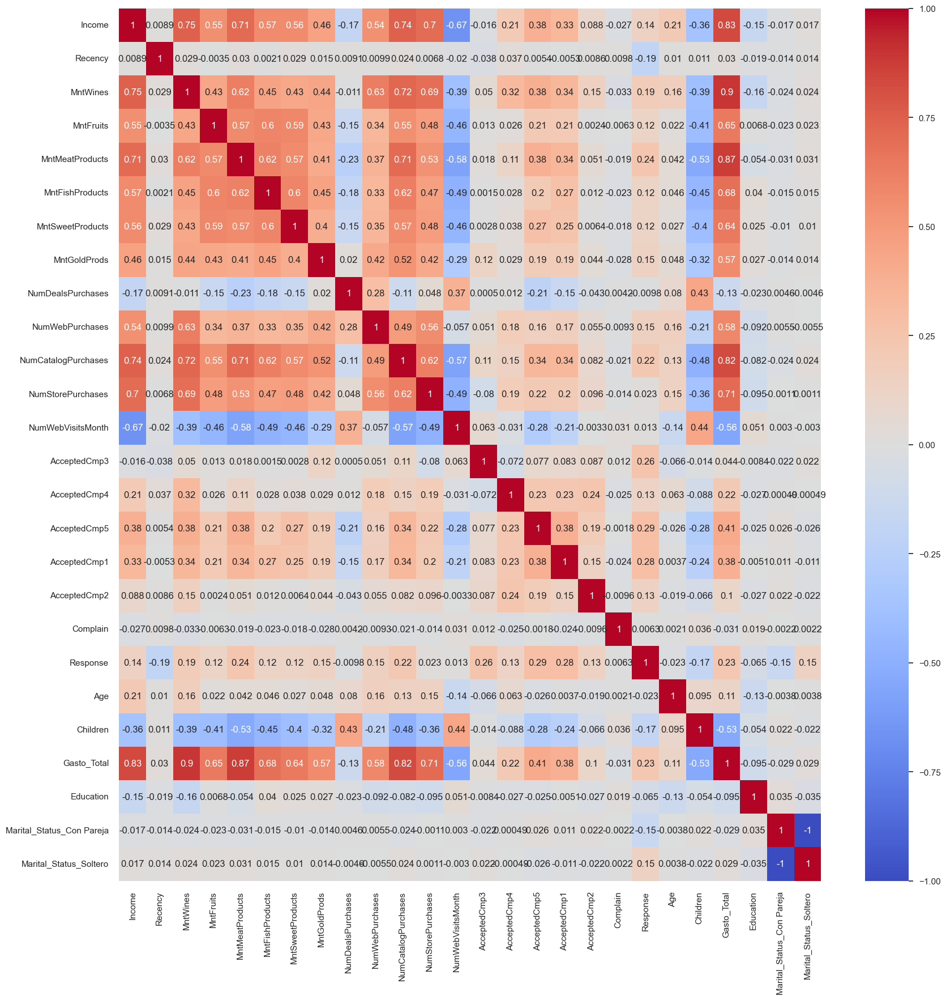

In [1056]:
corrmat= df_procesado.corr()
plt.figure(figsize=(20,20))  
sns.heatmap(corrmat,annot=True, cmap='coolwarm', center=0)

>**Observación**
>- En esta gráfica de correlación se puede observar que se tiene en gran proporción columnas altamente correlacionadas, el cual se podria usar PCA

In [1057]:
from sklearn.decomposition import PCA

In [1058]:
pca = PCA()
pca.fit(df_procesado)

PCA()

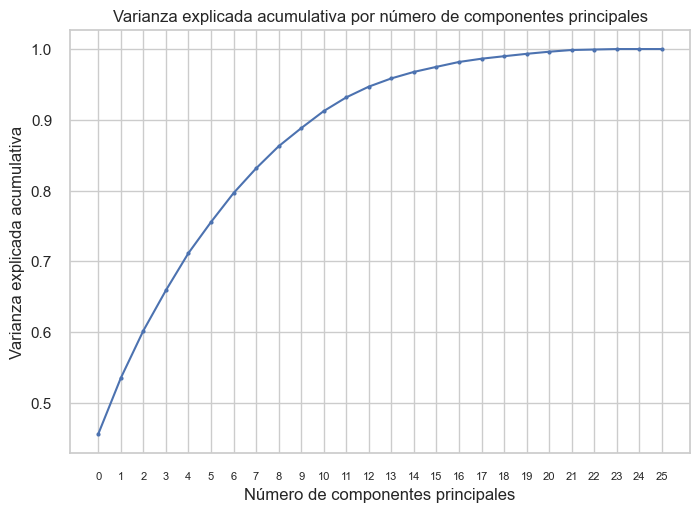

In [1059]:
plt.plot(range(0, 26), pca.explained_variance_ratio_.cumsum(), marker= '.')
plt.xticks(ticks=range(0, 26), fontsize=8)
plt.xlabel('Número de componentes principales')
plt.ylabel('Varianza explicada acumulativa')
plt.title('Varianza explicada acumulativa por número de componentes principales')
plt.grid(True)
plt.show()

>**Observción**
>- Se observa en el gráfico que  podemos tomar 21 como número de componentes principales, y la varianza estaria cercano a 1

In [1060]:
from sklearn.decomposition import PCA
from sklearn.preprocessing import RobustScaler
pca = PCA(n_components = 21)
robust_scaler = RobustScaler()
pca_escalado = make_pipeline(robust_scaler,pca)
pca_escalado = pca_escalado.fit_transform(df_procesado)

In [1061]:
pca_escalado.shape

(2056, 21)

In [1062]:
print('Numero de filas y columnas antes del PCA:', df_procesado.shape)
print('Numero de filas y columnas despues de aplicar PCA:', pca_escalado.shape)
print('Numero de columnas reducidas: ',  df_procesado.shape[1] - pca_escalado.shape[1])

Numero de filas y columnas antes del PCA: (2056, 26)
Numero de filas y columnas despues de aplicar PCA: (2056, 21)
Numero de columnas reducidas:  5


**6.2 Entrenamiento de nuestros modelos**

- *6.2.1 Entrenamiento de nuestro modelo K-MEANS*


In [1063]:
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score, davies_bouldin_score

In [1064]:
inercias = []
k_clusters = range(2,11)
for n in k_clusters:
    kmeans = (KMeans(n_clusters = n ,
                        init = 'k-means++',
                        n_init = 10,
                        max_iter=300,
                        tol = 0.0001,
                        random_state= 123 ,
                        algorithm='elkan') ).fit(pca_escalado)
    inercias.append(kmeans.inertia_)

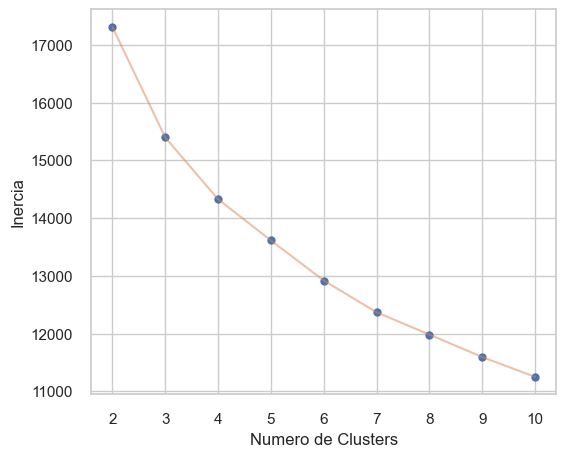

In [1065]:

plt.figure(figsize=(6,5), dpi=100)
plt.plot(range(2,11), inercias , 'o')
plt.plot(range(2,11), inercias , '-' , alpha = 0.5)
plt.xlabel('Numero de Clusters',fontsize = 12) 
plt.ylabel('Inercia',fontsize = 12)
plt.show()

*KMeans con 2 clusters*

In [1066]:
k = 2
kmeans = KMeans(n_clusters = k ,
                        init = 'k-means++',
                        n_init = 10,
                        max_iter=300,
                        tol = 0.0001,
                        random_state= 123 ,
                        algorithm='elkan') 

kmeans.fit(pca_escalado)
y_pred_2 = kmeans.predict(pca_escalado)
y_pred_2

array([1, 0, 1, ..., 1, 1, 0])

In [1067]:
silhouette_score(pca_escalado, kmeans.labels_)

0.38020658979158195

>**Observación**
>- El Silhouette score es bastante bajo, por lo general debe estar cercano al 1 para obtener clusters bien formados, en este caso se tiene un valor de 0.3802.

In [1068]:
data_prueba = df.copy(deep=True)

In [1069]:
data_prueba['cluster2'] = y_pred_2

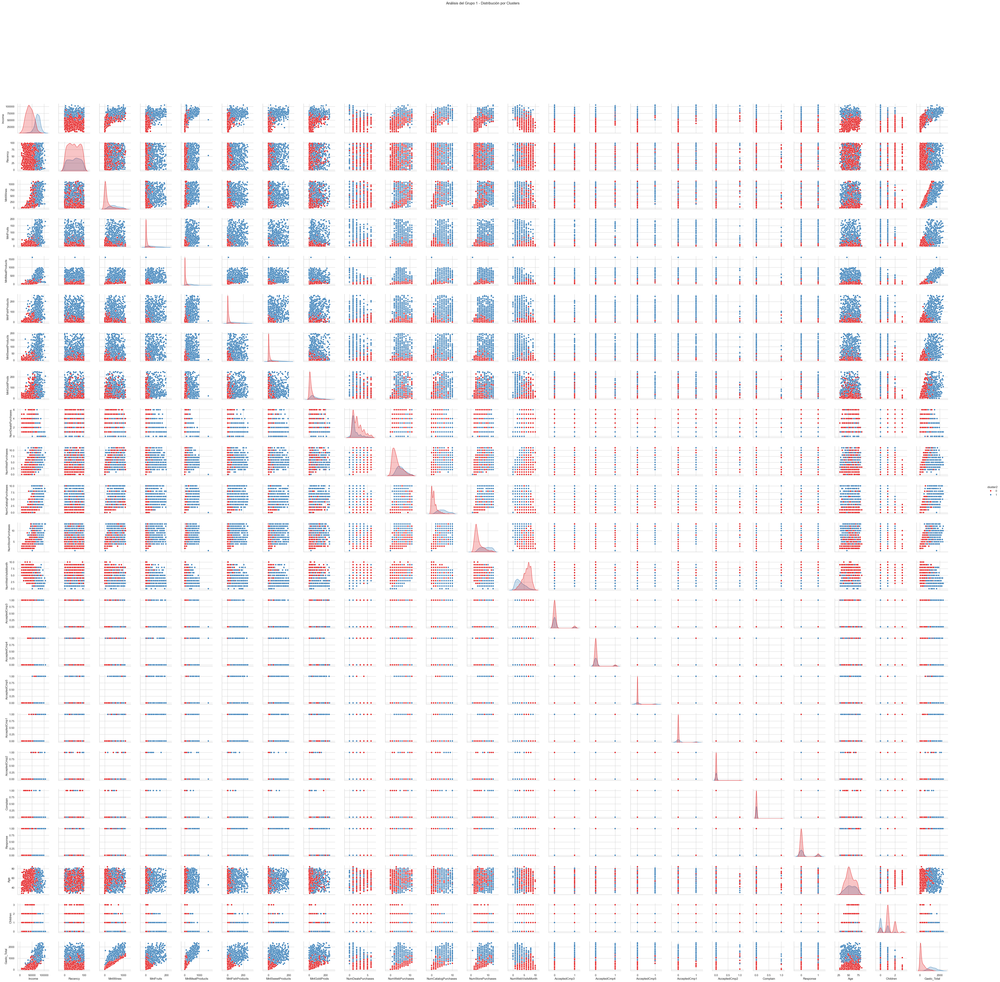

In [1070]:
import seaborn as sns
import matplotlib.pyplot as plt

sns.pairplot(data_prueba, hue='cluster2', palette='Set1')
plt.subplots_adjust(left=0.05, right=0.95, top=0.9, bottom=0.05, wspace=0.3, hspace=0.3)
plt.suptitle("Análisis del Grupo 1 - Distribución por Clusters", y=1.0, x=0.5) 
plt.show()

*KMeans con 3 clusters*

In [1071]:
k = 3
kmeans = KMeans(n_clusters = k ,
                        init = 'k-means++',
                        n_init = 10,
                        max_iter=300,
                        tol = 0.0001,
                        random_state= 123 ,
                        algorithm='elkan') 

kmeans.fit(pca_escalado)
y_pred_3 = kmeans.predict(pca_escalado)
y_pred_3

array([1, 2, 0, ..., 0, 0, 2])

In [1072]:
silhouette_score(pca_escalado, kmeans.labels_)

0.24626380983334006

>**Observación**
>- El Silhouette score es bastante bajo, por lo general debe estar cercano al 1 para obtener clusters bien formados, en este caso se tiene un valor de 0.2462

In [1073]:
data_prueba['cluster3'] = y_pred_3

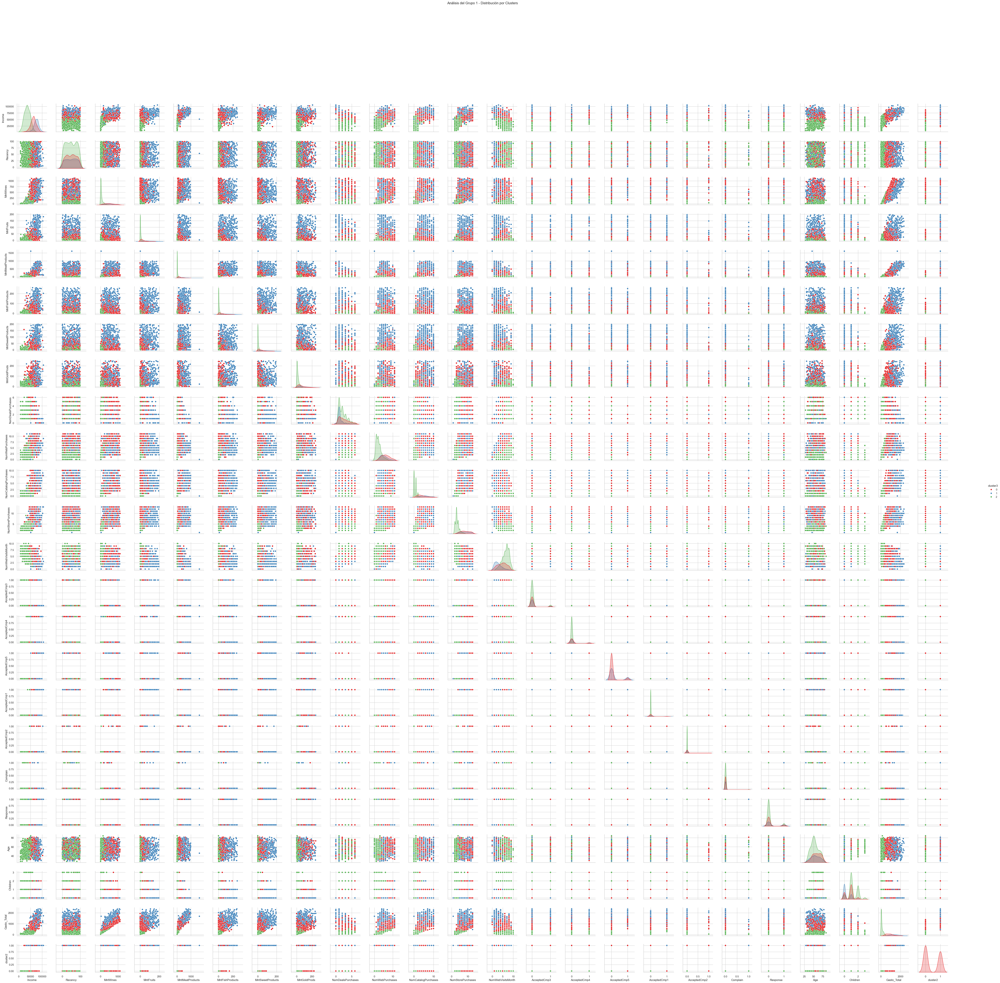

In [1074]:
sns.pairplot(data_prueba, hue='cluster3', palette='Set1')
plt.subplots_adjust(left=0.05, right=0.95, top=0.9, bottom=0.05, wspace=0.3, hspace=0.3)
plt.suptitle("Análisis del Grupo 1 - Distribución por Clusters", y=1.0, x=0.5) 
plt.show()

*KMeans con 4 clusters*

In [1075]:
k = 4
kmeans = KMeans(n_clusters = k ,
                        init = 'k-means++',
                        n_init = 10,
                        max_iter=300,
                        tol = 0.0001,
                        random_state= 123 ,
                        algorithm='elkan') 

kmeans.fit(pca_escalado)
y_pred_4 = kmeans.predict(pca_escalado)
y_pred_4

array([1, 0, 3, ..., 3, 3, 0])

In [1076]:
silhouette_score(pca_escalado, kmeans.labels_)

0.1950858867836715

>**Observación**
>- El Silhouette score es bastante bajo a comparación con los clusters formado por 2 y 3, por lo general debe estar cercano al 1 para obtener clusters bien formados,en este caso se tiene un valor de 0.1950.

In [1077]:
data_prueba['cluster4'] = y_pred_4

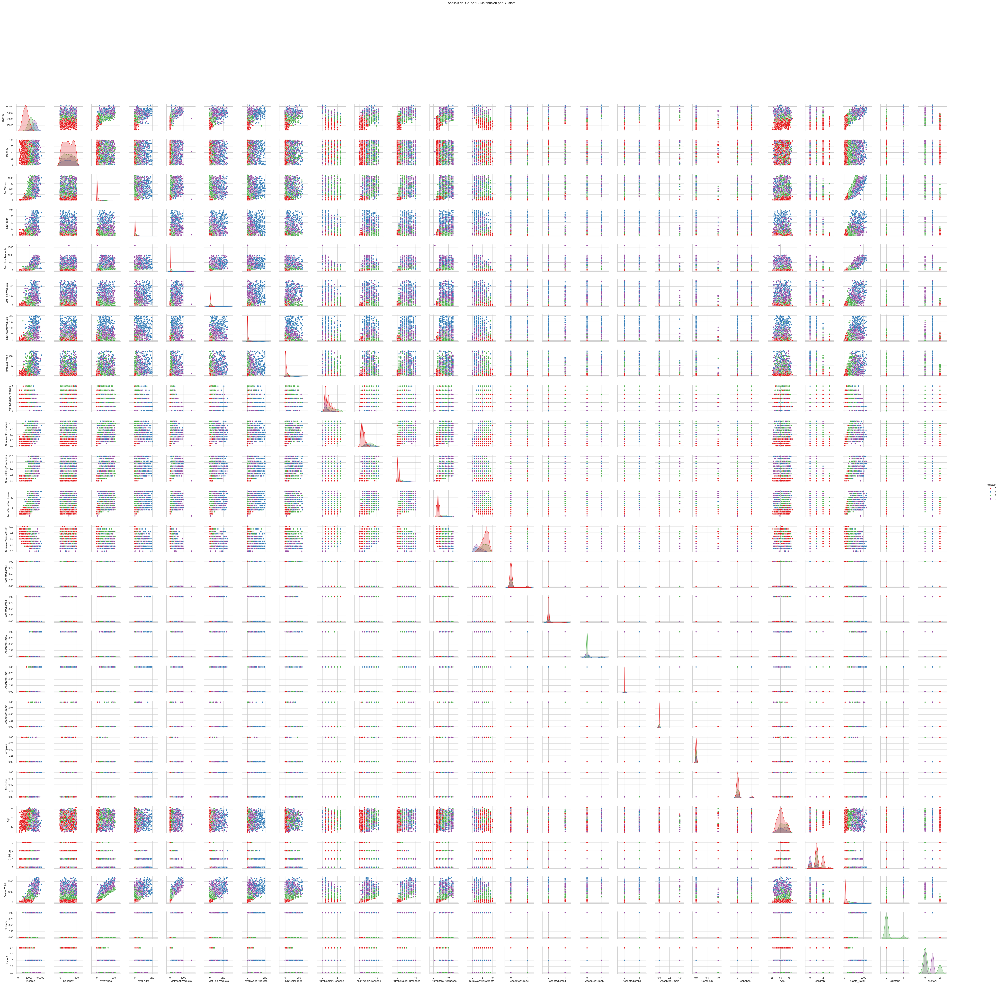

In [1078]:
sns.pairplot(data_prueba, hue='cluster4', palette='Set1')
plt.subplots_adjust(left=0.05, right=0.95, top=0.9, bottom=0.05, wspace=0.3, hspace=0.3)
plt.suptitle("Análisis del Grupo 1 - Distribución por Clusters", y=1.0, x=0.5) 
plt.show()

**6.3 Evaluación de nuestra CLASIFICACIÓN**

- K = 2 = 0.3802
- K = 3 = 0.2462
- K = 4 = 0.1950

In [1079]:
K_values = [2, 3, 4]
metrics = [0.3802, 0.2462,  0.1950]


data = {'K': K_values, 'Silhouette score': metrics}
dm = pd.DataFrame(data)

df_sorted = dm.sort_values(by='Silhouette score', ascending=False)
   

print(df_sorted)

   K  Silhouette score
0  2            0.3802
1  3            0.2462
2  4            0.1950


>**Interpretación de los valores:**
>- k=2: Score de 0.3802 indica una buena separación entre los dos clusters y una cohesión interna decente.
>- k=3: Score de 0.2462 indica una separación aceptable entre los tres clusters, pero una cohesión interna ligeramente menor en comparación con k=2.
>- k=4: Score de 0.1950 indica una separación mediocre entre los cuatro clusters y una cohesión interna deficiente.

> En base a esta interpretación eligiremos k con 3 clusters, el cual queremos agrupar a nuestros clientes por 3 diferentes grupos y hacer gráficos en base a ello y ver como se ha comportado la personalidad de nuestros clientes.

data

In [1080]:
data_prueba

,Education,Marital_Status,Income,Recency,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds,...,AcceptedCmp1,AcceptedCmp2,Complain,Response,Age,Children,Gasto_Total,cluster2,cluster3,cluster4
0,Graduation,Soltero,58138.0,58,635,88,546,172,88,88,...,0,0,0,1,67,0,1617,1,1,1
1,Graduation,Soltero,46344.0,38,11,1,6,2,1,6,...,0,0,0,0,70,2,27,0,2,0
2,Graduation,Con Pareja,71613.0,26,426,49,127,111,21,42,...,0,0,0,0,59,0,776,1,0,3
3,Graduation,Con Pareja,26646.0,26,11,4,20,10,3,5,...,0,0,0,0,40,1,53,0,2,0
4,Doctorate,Con Pareja,58293.0,94,173,43,118,46,27,15,...,0,0,0,0,43,1,422,0,0,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2234,Graduation,Con Pareja,34421.0,81,3,3,7,6,2,9,...,0,0,0,0,50,1,30,0,2,0
2235,Graduation,Con Pareja,61223.0,46,709,43,182,42,118,247,...,0,0,0,0,57,1,1341,1,1,1
2237,Graduation,Soltero,56981.0,91,908,48,217,32,12,24,...,0,0,0,0,43,0,1241,1,0,3
2238,Master,Con Pareja,69245.0,8,428,30,214,80,30,61,...,0,0,0,0,68,1,843,1,0,3


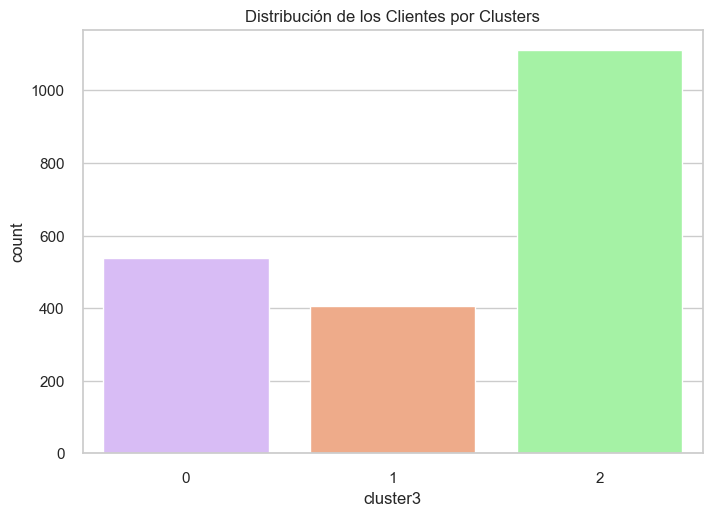

In [1081]:
pal = ["#D8B2FF", "#FFA579", "#98FF98"]
pl = sns.countplot(x="cluster3", data=data_prueba, palette=pal, hue="cluster3", legend=False)
pl.set_title("Distribución de los Clientes por Clusters")
plt.show()

>**Observación**
>- Se puede observar que se tiene más clientes en el grupo 2 y pocos clientes en el grupo 1 

In [1082]:
data_prueba

,Education,Marital_Status,Income,Recency,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds,...,AcceptedCmp1,AcceptedCmp2,Complain,Response,Age,Children,Gasto_Total,cluster2,cluster3,cluster4
0,Graduation,Soltero,58138.0,58,635,88,546,172,88,88,...,0,0,0,1,67,0,1617,1,1,1
1,Graduation,Soltero,46344.0,38,11,1,6,2,1,6,...,0,0,0,0,70,2,27,0,2,0
2,Graduation,Con Pareja,71613.0,26,426,49,127,111,21,42,...,0,0,0,0,59,0,776,1,0,3
3,Graduation,Con Pareja,26646.0,26,11,4,20,10,3,5,...,0,0,0,0,40,1,53,0,2,0
4,Doctorate,Con Pareja,58293.0,94,173,43,118,46,27,15,...,0,0,0,0,43,1,422,0,0,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2234,Graduation,Con Pareja,34421.0,81,3,3,7,6,2,9,...,0,0,0,0,50,1,30,0,2,0
2235,Graduation,Con Pareja,61223.0,46,709,43,182,42,118,247,...,0,0,0,0,57,1,1341,1,1,1
2237,Graduation,Soltero,56981.0,91,908,48,217,32,12,24,...,0,0,0,0,43,0,1241,1,0,3
2238,Master,Con Pareja,69245.0,8,428,30,214,80,30,61,...,0,0,0,0,68,1,843,1,0,3


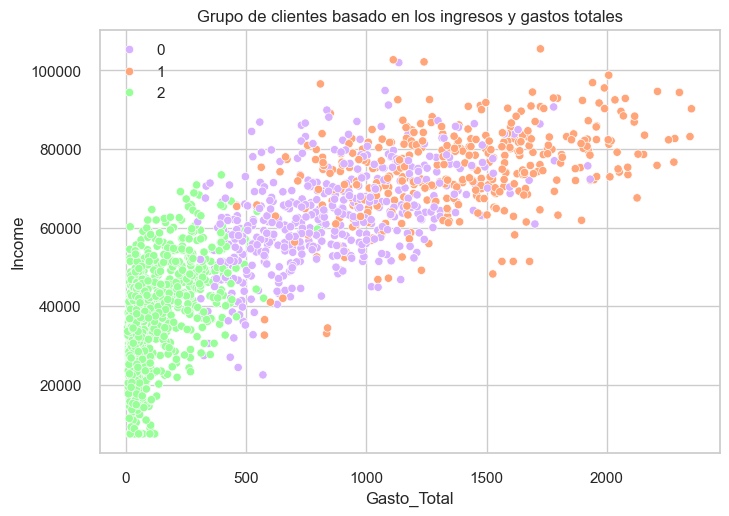

In [1083]:
pl = sns.scatterplot(data = data_prueba,x = data_prueba["Gasto_Total"], y = data_prueba["Income"],hue = data_prueba["cluster3"], palette= pal)
pl.set_title("Grupo de clientes basado en los ingresos y gastos totales")
plt.legend()
plt.show()

>**Observación**
>- Se puede observar que los clientes  del grupo 2 , tienen ingresos menores y sus gastos son menores.
>- Se puede observar que los clientes  del grupo 0 , tienen ingresos un poco más que los clientes del grupo 2 y sus gastos son mayores que el grupo 2.
>- Se puede observar que para los clientes  del grupo 1 son lso que tiene ingresos mucho mayores a los otro grupo de clientes y sus gastos son de la misma forma mayores.

In [1084]:
data_prueba.columns

Index(['Education', 'Marital_Status', 'Income', 'Recency', 'MntWines',
       'MntFruits', 'MntMeatProducts', 'MntFishProducts', 'MntSweetProducts',
       'MntGoldProds', 'NumDealsPurchases', 'NumWebPurchases',
       'NumCatalogPurchases', 'NumStorePurchases', 'NumWebVisitsMonth',
       'AcceptedCmp3', 'AcceptedCmp4', 'AcceptedCmp5', 'AcceptedCmp1',
       'AcceptedCmp2', 'Complain', 'Response', 'Age', 'Children',
       'Gasto_Total', 'cluster2', 'cluster3', 'cluster4'],
      dtype='object')

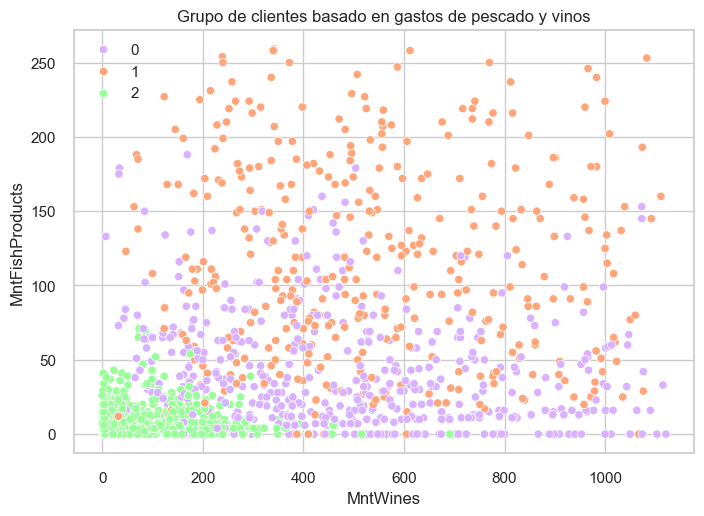

In [1085]:
pl = sns.scatterplot(data = data_prueba,x = data_prueba["MntWines"], y = data_prueba["MntFishProducts"],hue = data_prueba["cluster3"], palette= pal)
pl.set_title("Grupo de clientes basado en gastos de pescado y vinos")
plt.legend()
plt.show()

>**Observación**
>- Se puede observar que los clientes que consumen menos pescados y ala vez vinos son los clientes del grupo 2
>- Se puede observar que los clientes que consumen más vinos y alas vez pescados son los clientes del grupo 1

In [1086]:
data_prueba["Total_Promos"] = data_prueba["AcceptedCmp1"] + data_prueba["AcceptedCmp2"] + data_prueba["AcceptedCmp3"] + data_prueba["AcceptedCmp4"] + data_prueba["AcceptedCmp5"] +  data_prueba["Response"]

In [1087]:
data_prueba["Total_Promos"].value_counts()

Total_Promos
0    1533
1     338
2     116
3      38
4      26
5       5
Name: count, dtype: int64

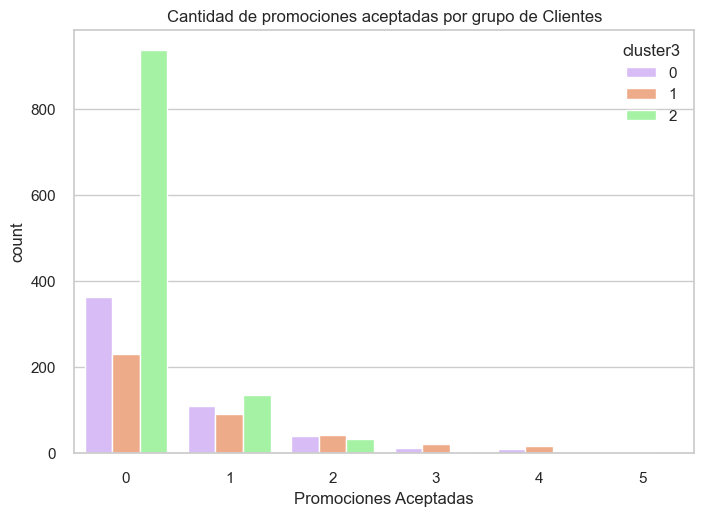

In [1088]:
plt.figure()
pl = sns.countplot(x= data_prueba["Total_Promos"],hue= data_prueba["cluster3"], palette= pal)
pl.set_title("Cantidad de promociones aceptadas por grupo de Clientes")
pl.set_xlabel("Promociones Aceptadas")
plt.show()

>**Observación**
>- Se puede observar que se tiene muchos clientes que no han acepta las promociones que se ha tenido y debemos de averiguar el por que de ello,, ademas en su mayoria son del grupo 2.
>- Se puede observar que los clientes del grupo 1 hay unos cuantos clientes que han aceptado las 4 promociones , se puede hacer campañas de promociones para esos tipos de clientes.

**Exportando nuestra data con nuestros resultados y con los clusters**

In [1090]:
data_prueba.to_csv('data_clustering.csv', index=True, header=True, encoding='utf-8')

<a id='sec_7'></a>
## `7. Reporte final`

En este caso debemos dar nuestra conclusión y sugerencias

1. Conclusiones
2. Sugerencias

**7.1 Conclusiones**

- De acuerdo a nuestro analisis exploratorio , analisis predictivo(clasificación), se puede concluir que nuestra mejor clusterización de los estudiantes es tener a 3 grupos el cual esto tambien dependera de muchos factores ya sea por la empresa o otros factores ajenos a ello.

- Se realizo un poco del compartamiento de nuestros resultados sobre la personalidad de neustros clientes y se observo en algunos gráficos algunos patrones como los clientes que gastan más son los clientes con más salarios es decir grupo 1 , quizas para ellos en otras campañas ofrecerles productos en base a sus compras realizadas.

- Sea observo otro comportamiento que los clientes del grupo 1, son los que más compras vinos y pescados , quizas se pueda hacer una promoción para este grupo de clientes y mejorar nuestras ventas.

- Se observo un compartamiento en las campañas realizadas y esque hay muchos clientes de todos los grupos en la campaña 1(0) que no han optado por esta , quizas una mejor inspección del por que ayudaria a mejorar nuestra siguiente campaña , des los errores se aprende.

**7.2 Recomendación**

- Se recomienda que se pueda usar otros tipos de Algoritmo de agrupamiento para poder mejorar una mejor clusterización.

- Se recomienda revisar o tratar valores outliers de mejor manera debido a que se cuenta en varios outliers.

- Se recomienda poder usar Deep Learning para poder mejorar nuestra clasificación. 
